<a href="https://colab.research.google.com/github/usernotabuser/diffusion-nbs/blob/master/stability_xl.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -Uq diffusers transformers fastcore

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 12.7 MB/s eta 0:00:00


In [2]:
!pip install invisible_watermark transformers accelerate safetensors

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 13.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 261.4/261.4 kB 15.8 MB/s eta 0:00:00


In [3]:
import logging
from pathlib import Path

import matplotlib.pyplot as plt
import torch
from diffusers import DiffusionPipeline
from fastcore.all import concat
from huggingface_hub import notebook_login
from PIL import Image

logging.disable(logging.WARNING)

torch.manual_seed(1)
if not (Path.home()/'.cache/huggingface'/'token').exists(): notebook_login()

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [4]:
pipe = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16, use_safetensors=True, variant="fp16")
pipe.to("cuda")

# if using torch < 2.0
# pipe.enable_xformers_memory_efficient_attention()



model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

tokenizer_2/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

tokenizer_2/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

StableDiffusionXLPipeline {
  "_class_name": "StableDiffusionXLPipeline",
  "_diffusers_version": "0.23.1",
  "_name_or_path": "stabilityai/stable-diffusion-xl-base-1.0",
  "force_zeros_for_empty_prompt": true,
  "scheduler": [
    "diffusers",
    "EulerDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [18]:
prompt = "A beautyfull young woman with a dark hair and brown eyes, dancing in the club and smilling, photography"

  0%|          | 0/64 [00:00<?, ?it/s]

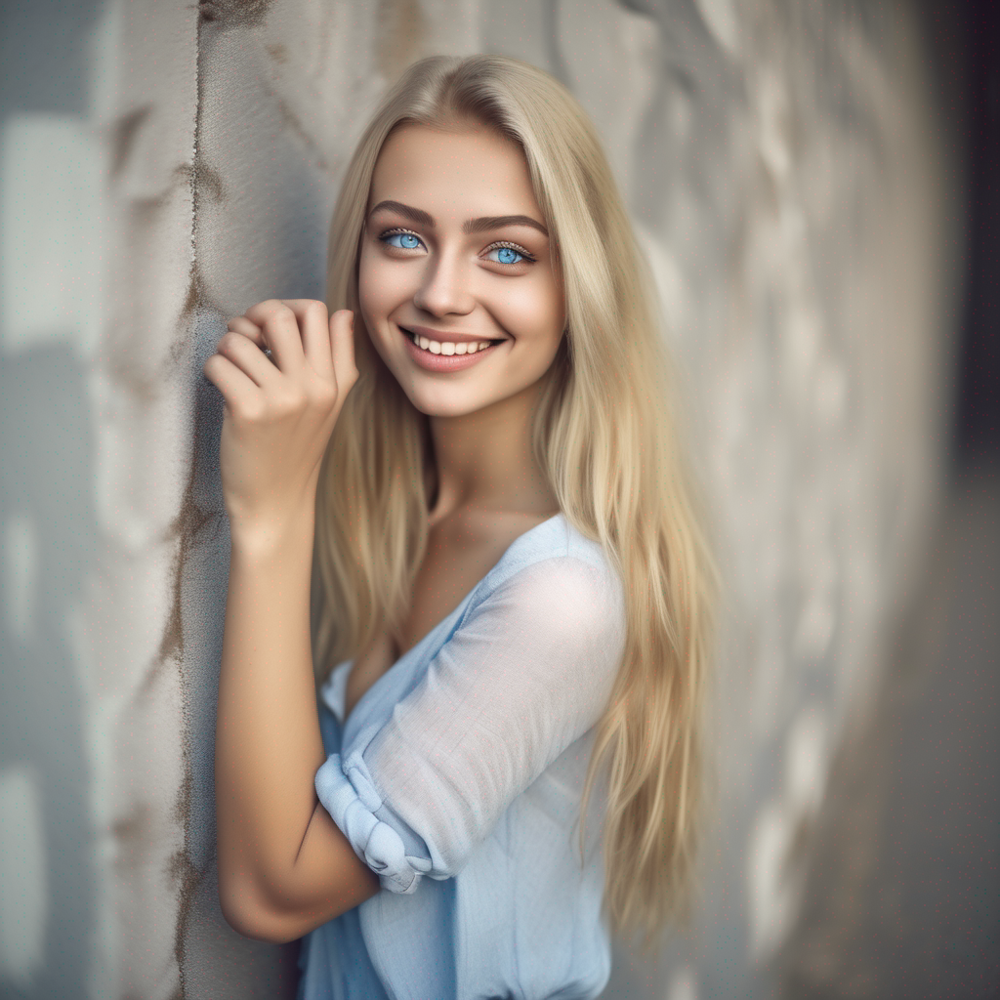

In [8]:
#torch.manual_seed(1024)
pipe(prompt, guidance_scale=12, num_inference_steps=64).images[0]


  0%|          | 0/64 [00:00<?, ?it/s]

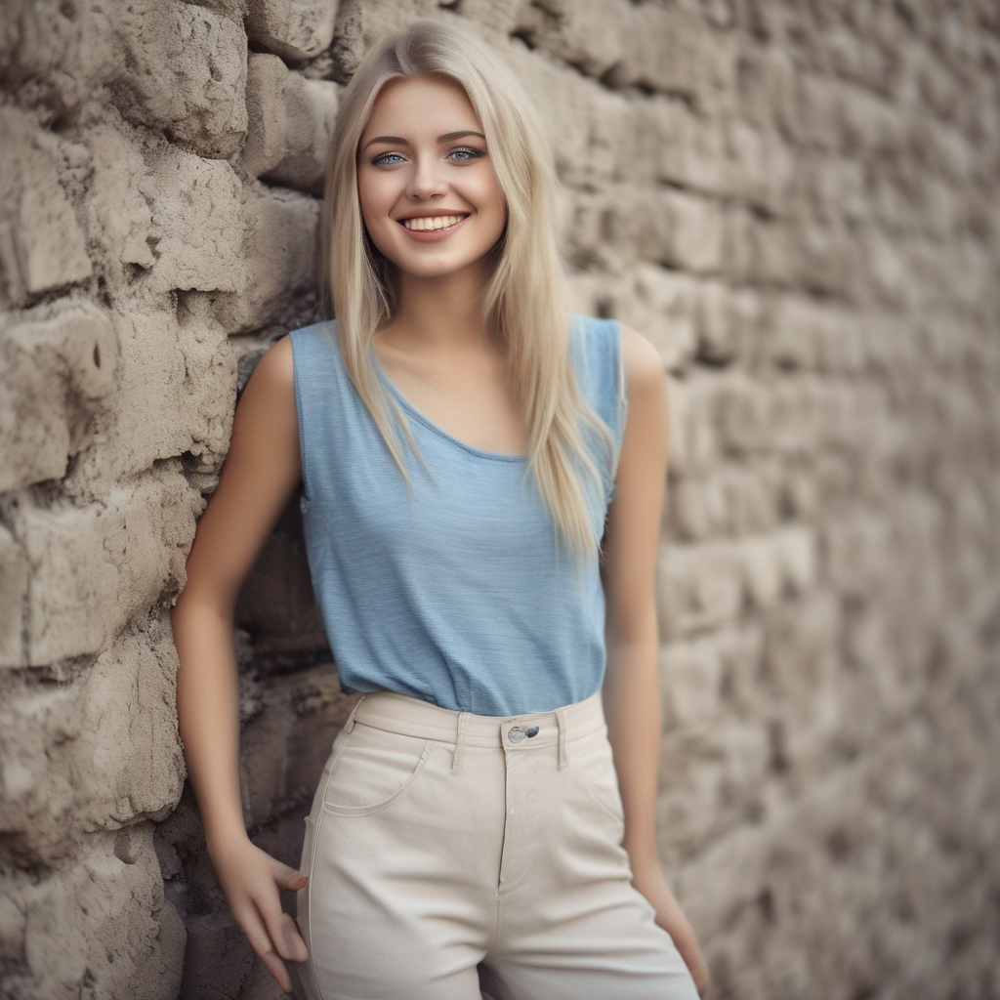

In [9]:
torch.manual_seed(1024)
pipe(prompt, guidance_scale=7, num_inference_steps=64).images[0]

  0%|          | 0/64 [00:00<?, ?it/s]

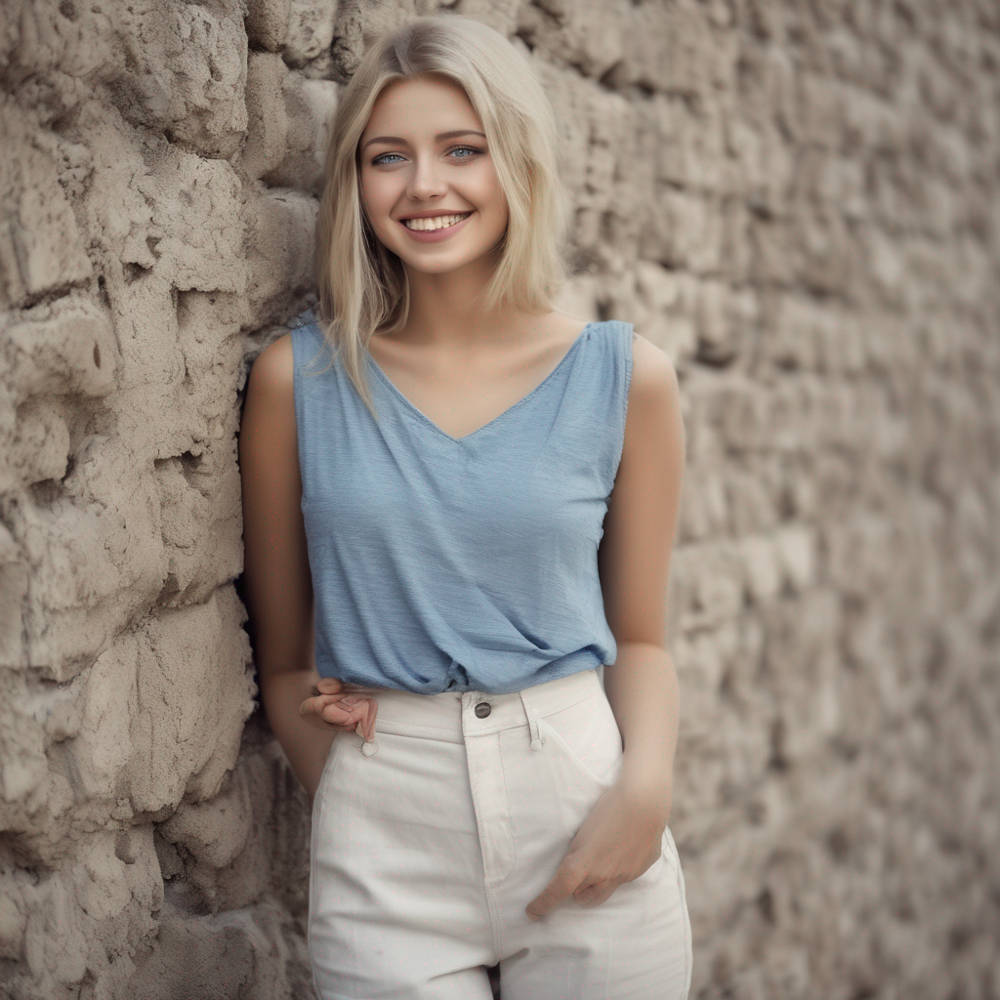

In [10]:
torch.manual_seed(1024)
pipe(prompt, guidance_scale=5, num_inference_steps=64).images[0]

  0%|          | 0/64 [00:00<?, ?it/s]

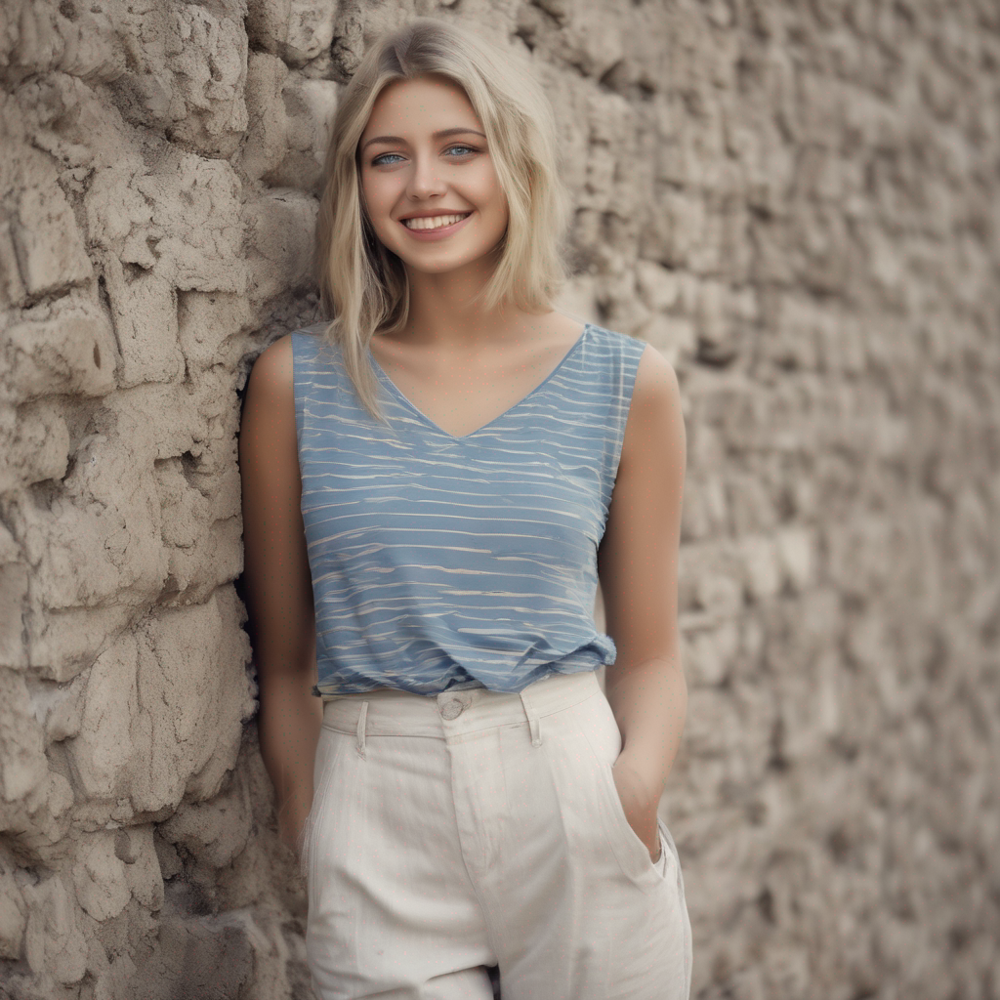

In [12]:
torch.manual_seed(1024)
pipe(prompt, guidance_scale=4, num_inference_steps=64).images[0]

  0%|          | 0/64 [00:00<?, ?it/s]

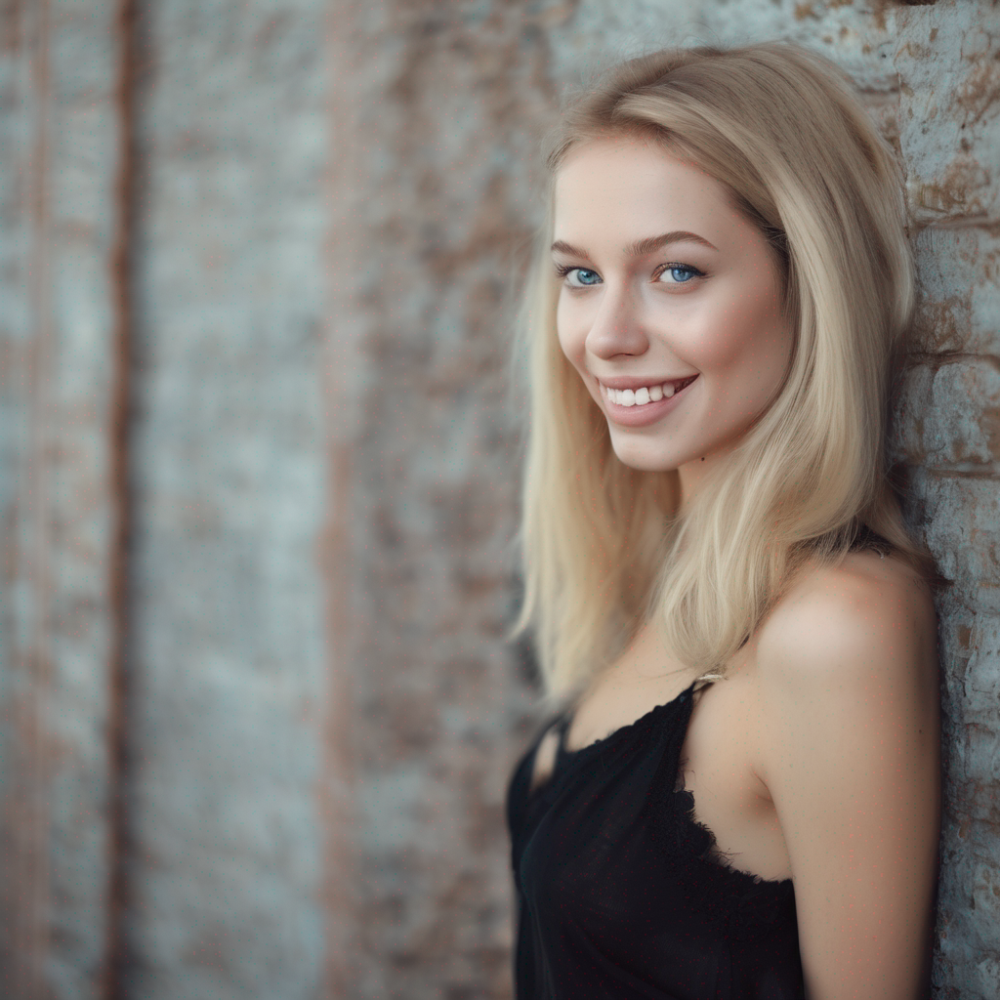

In [16]:
torch.manual_seed(12404)
pipe(prompt, guidance_scale=4, num_inference_steps=64).images[0]

  0%|          | 0/64 [00:00<?, ?it/s]

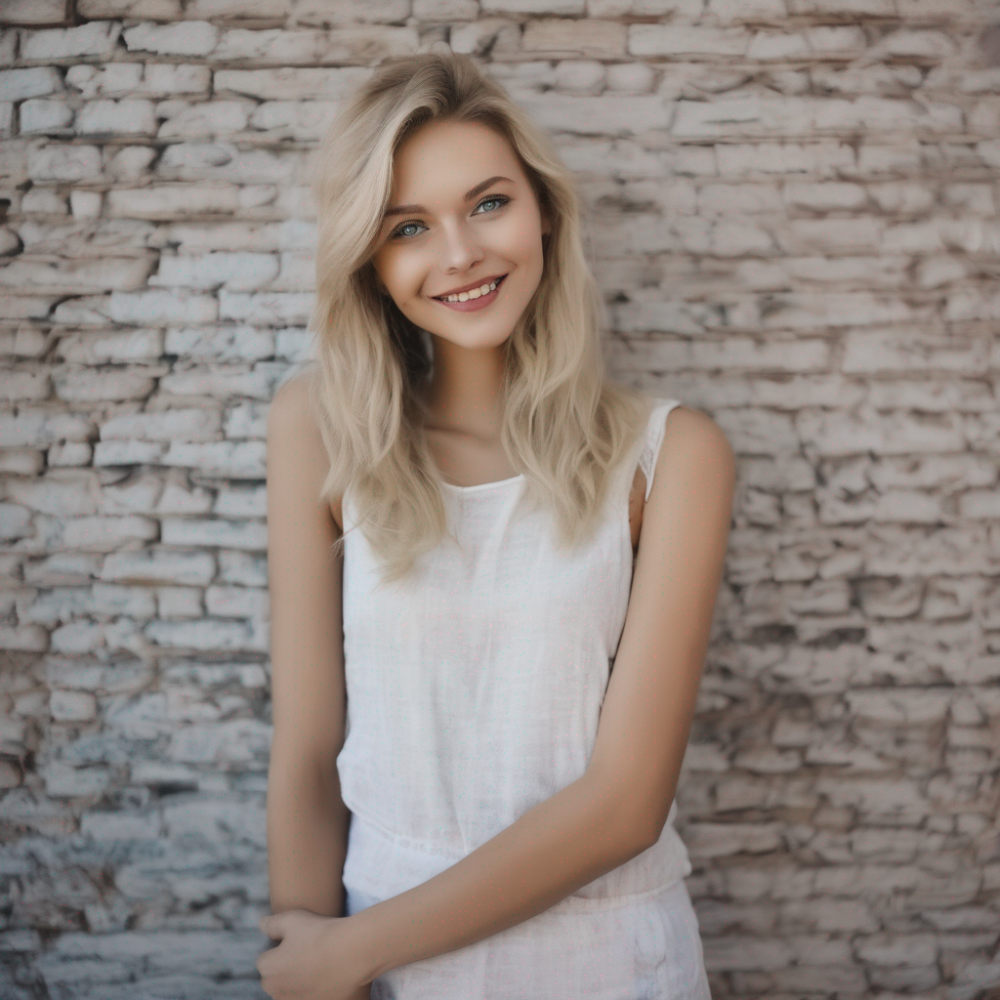

In [17]:
torch.manual_seed(1404)
pipe(prompt, guidance_scale=4, num_inference_steps=64).images[0]

  0%|          | 0/64 [00:00<?, ?it/s]

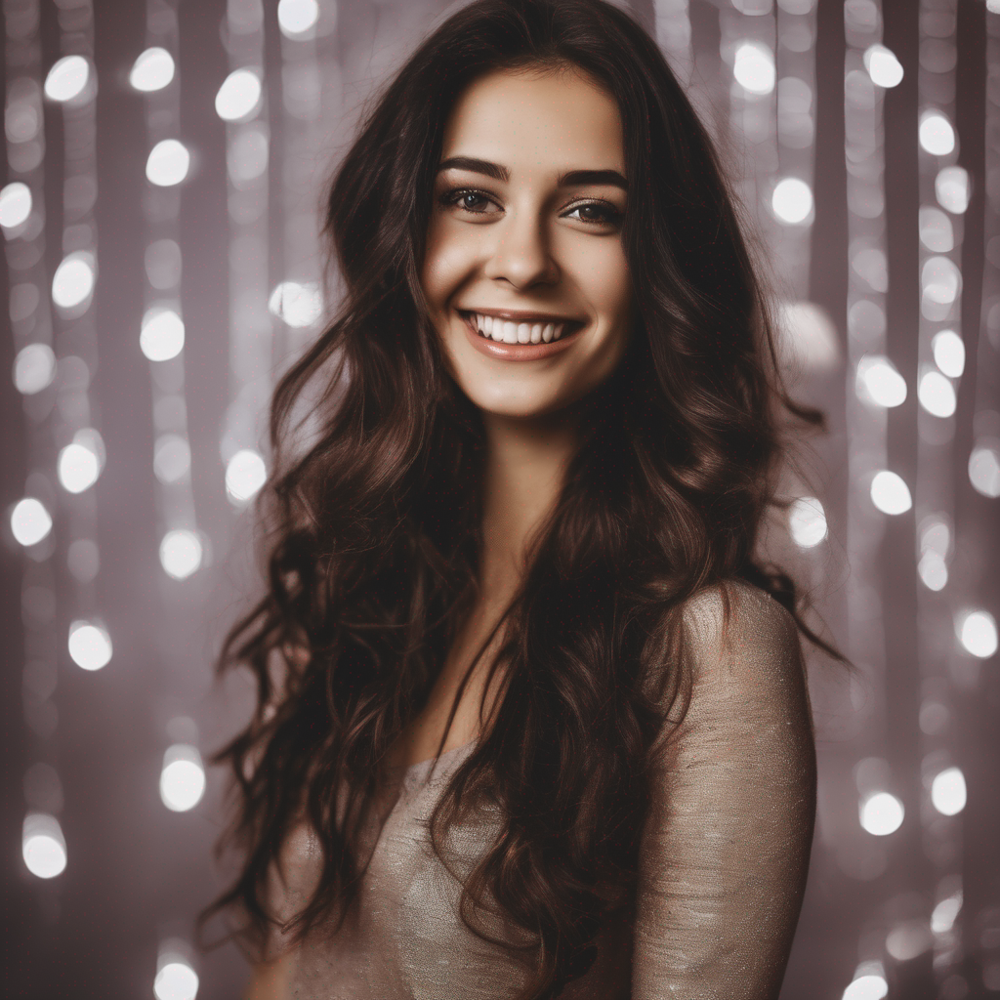

In [19]:
prompt = "A beautyfull young woman with a dark hair and brown eyes, dancing in the club and smilling, photography"

torch.manual_seed(2004)
pipe(prompt, guidance_scale=5, num_inference_steps=64).images[0]


  0%|          | 0/72 [00:00<?, ?it/s]

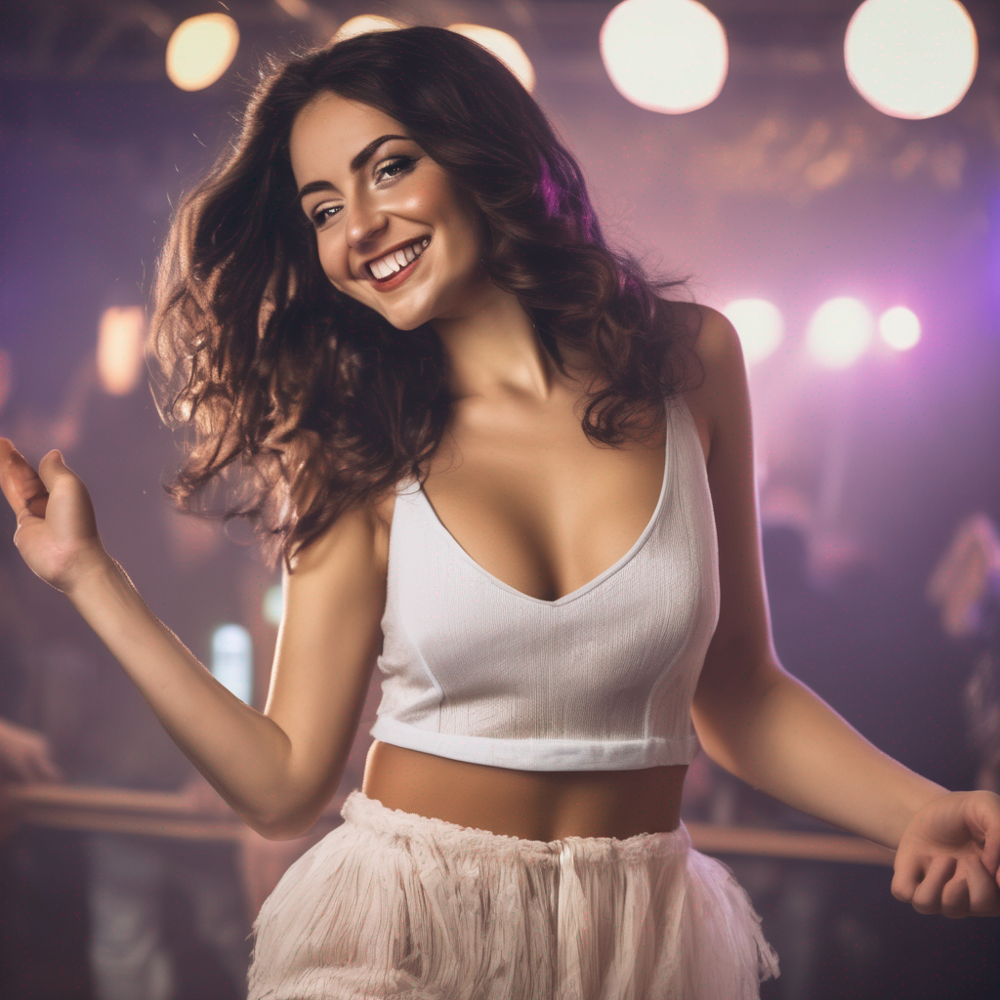

In [21]:
prompt = "A beautyfull young woman with a dark hair and brown eyes, dancing in the club and smilling, photography"

torch.manual_seed(2244)
pipe(prompt, guidance_scale=6, num_inference_steps=72).images[0]


  0%|          | 0/50 [00:00<?, ?it/s]

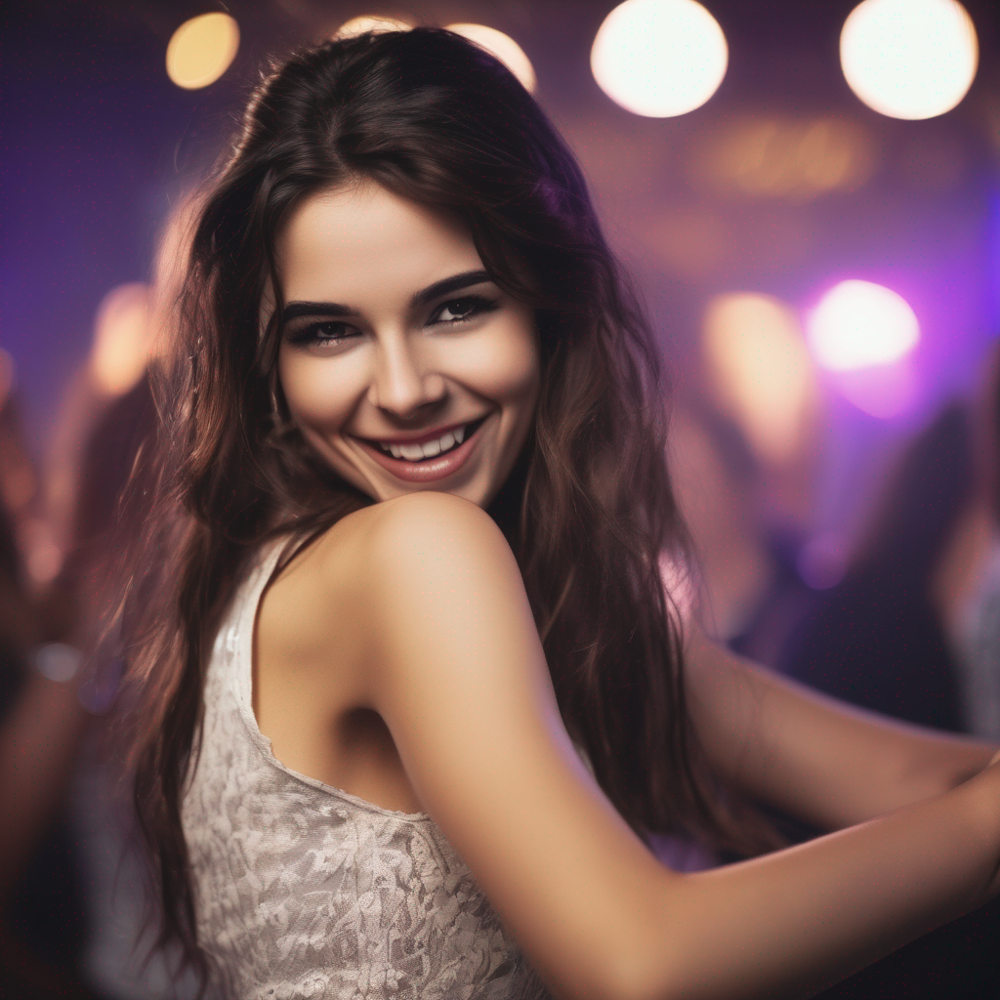

In [22]:
prompt = "A beautyfull young woman with a dark hair and brown eyes, dancing in the club and smilling, photography"

torch.manual_seed(2244)
pipe(prompt, guidance_scale=5, num_inference_steps=50).images[0]

  0%|          | 0/64 [00:00<?, ?it/s]

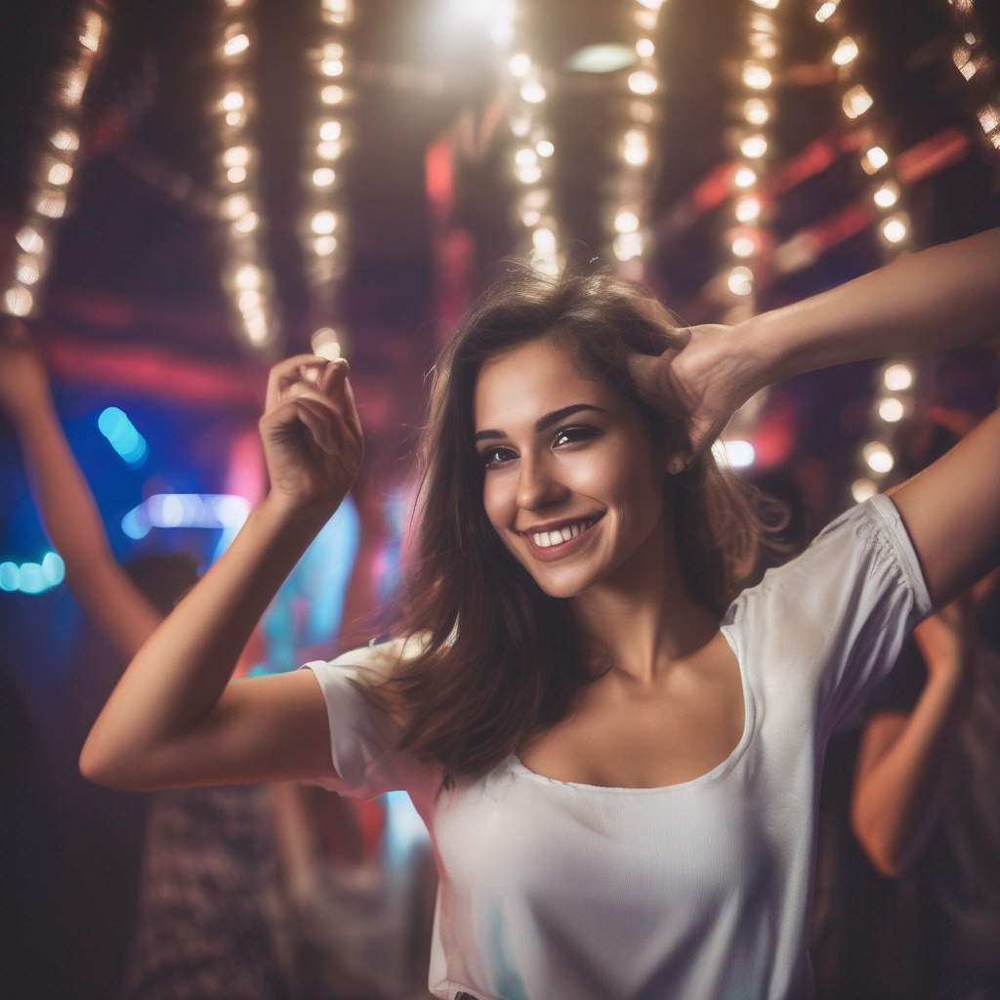

In [23]:
prompt = "A beautyfull young woman with a dark hair and brown eyes, dancing in the club and smilling, photography"

torch.manual_seed(2102)
pipe(prompt, guidance_scale=5, num_inference_steps=64).images[0]

  0%|          | 0/64 [00:00<?, ?it/s]

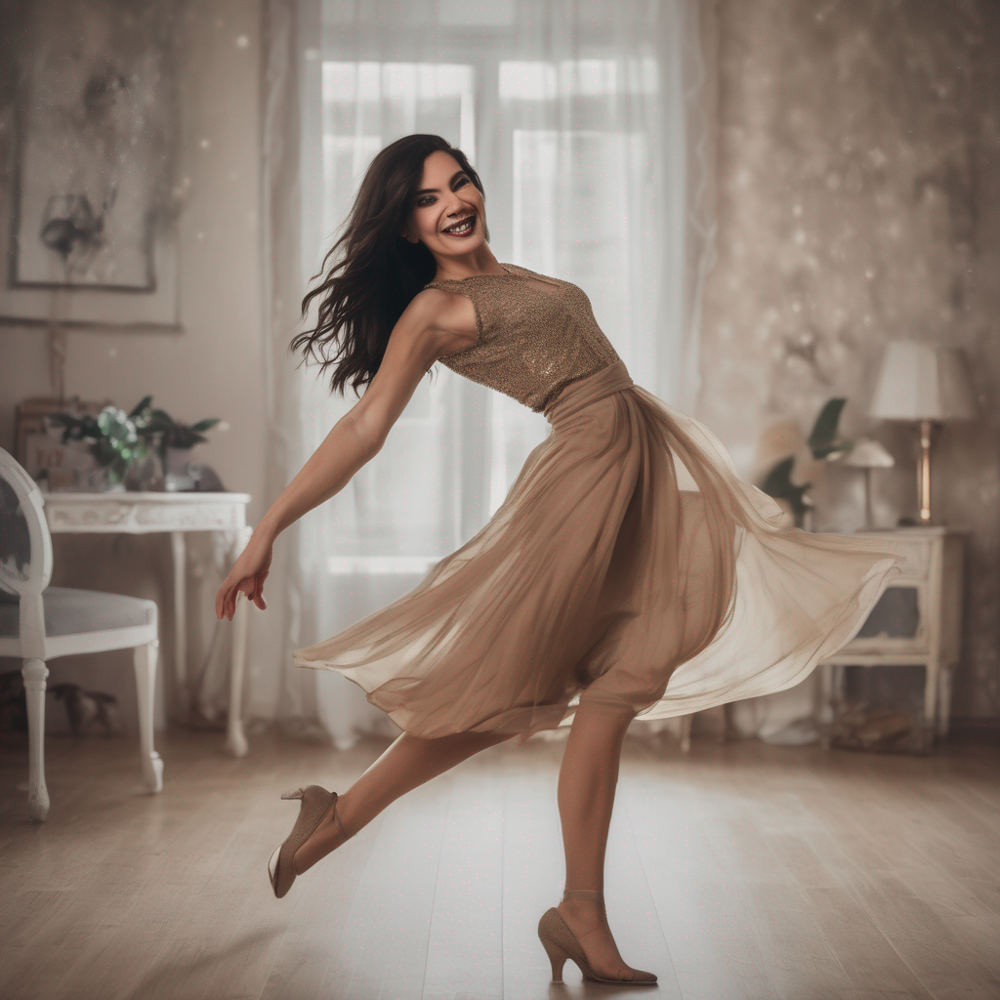

In [24]:
prompt = "A young woman with a dark hair and brown eyes, dancing in the home and smilling, photography"

torch.manual_seed(2102)
pipe(prompt, guidance_scale=5, num_inference_steps=64).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

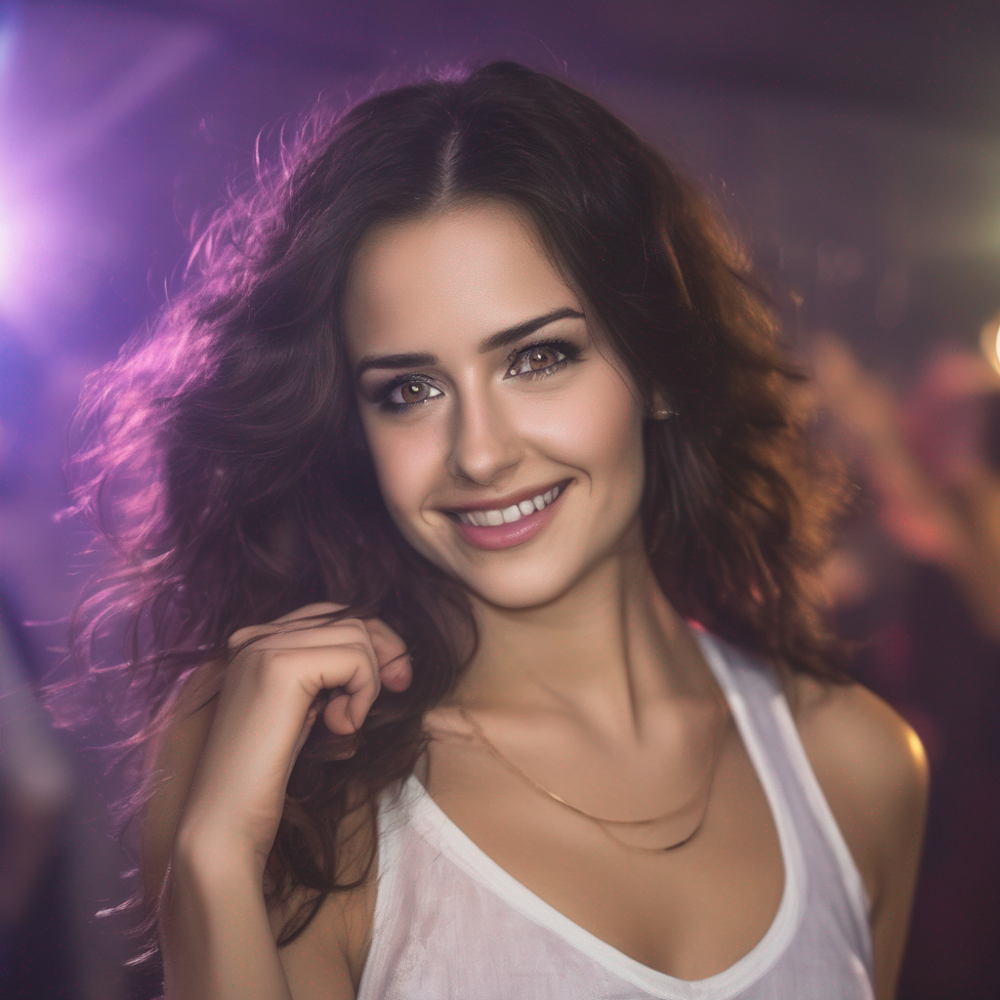

In [25]:
prompt = "A beautyfull young woman with a dark hair and brown eyes, dancing in the club and smilling, photography"

torch.manual_seed(1022)
pipe(prompt, guidance_scale=4, num_inference_steps=50).images[0]

In [15]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [20]:
num_rows,num_cols = 4,1
prompts = [prompt] * num_rows

In [21]:
images = concat(pipe(prompts, guidance_scale=g).images for g in [8,10,12])

  0%|          | 0/50 [00:00<?, ?it/s]

OutOfMemoryError: ignored